# Lecture 23 AI Social Media Strategy
This notebook will use AI to develop a social media strategy.

Below is the overview of this notebook.

<ol type = 1>
  <li> Enhance Video Content</li>
  <li> Match Influencers and Brands </li>
  <li> Create Content for Brand </li>
</ol>

This notebook can be opened in Colab
[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/zlisto/social_media_analytics/blob/main/Lecture23_AISocialMediaStrategy.ipynb)

Before starting, select "Runtime->Factory reset runtime" to start with your directories and environment in the base state.

If you want to save changes to the notebook, select "File->Save a copy in Drive" from the top menu in Colab.  This will save the notebook in your Google Drive.


# Clones, Installs, and Imports


In [1]:
!git clone https://github.com/zlisto/social_media_analytics

import os
os.chdir("social_media_analytics")

Cloning into 'social_media_analytics'...
remote: Enumerating objects: 2902, done.
remote: Counting objects: 100% (313/313), done.
remote: Compressing objects: 100% (170/170), done.
remote: Total 2902 (delta 150), reused 304 (delta 143), pack-reused 2589
Receiving objects: 100% (2902/2902), 294.70 MiB | 34.14 MiB/s, done.
Resolving deltas: 100% (539/539), done.
Updating files: 100% (2020/2020), done.


## Installs

We will need `openai` and `umap`.

In [3]:
!pip install openai -q
!pip install umap-learn -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.5/311.5 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 8.1 MB/s eta 0:00:00


## Imports

In [5]:
import pandas as pd
import numpy as np
import os
import pickle
import json
import re
import textwrap as tr
import time

#image processing packages
import tensorflow as tf
import tensorflow_hub as hub
import requests
from PIL import Image as PILImage

from io import BytesIO
import base64
import cv2  # We're using OpenCV to read video, to install !pip install opencv-python
from IPython.display import display, Image, HTML, Audio

#plotting packages
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sns
import plotly.express as px

#Image processing with Resnet
import torch
from torchvision import models, transforms
from sklearn.preprocessing import StandardScaler


#Low-dimensional embedding packages
from sklearn.decomposition import PCA
from umap import UMAP

#Clustering packages
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

#OpenAI API
import openai

#Progress bar packages
from tqdm import tqdm
from tqdm import tqdm_notebook
tqdm_notebook().pandas()

pd.set_option("display.max_colwidth", None)
plt.rcParams['figure.figsize'] = [8, 6]  # Width=8 inches, height=6 inches
plt.rc('axes', titlesize=18)
plt.rc('axes', labelsize=18)
plt.rc('xtick', labelsize=14)
plt.rc('ytick', labelsize=14)

<ipython-input-5-f7ef55796220>:48: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  tqdm_notebook().pandas()


0it [00:00, ?it/s]

## OpenAI API Key

You can get your OpenAI API key from https://platform.openai.com/api-keys.
Paste your key into the environment variable `"OPEN_API_KEY"`.  Then create a `client` that connects you to the OpenAI API.

In [6]:
os.environ['OPENAI_API_KEY'] = ''

OPENAI_API_KEY = os.getenv('OPENAI_API_KEY')

client = openai.Client(api_key=OPENAI_API_KEY)

#MODEL = 'gpt-3.5-turbo'
MODEL = 'gpt-4-turbo-preview'

## Helper Functions

You can put any custom functions you will need here so they do not clutter up your code.





In [7]:
def encode_image(image_path):
  '''Encodes an image to base64'''
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')

def get_embedding(text, model="text-embedding-3-large"):
    text = text.replace("\n", " ")
    return client.embeddings.create(input = [text], model=model).data[0].embedding

def get_completion(prompt, instructions, client, model="gpt-3.5-turbo",
                   output_type = 'text'):
  '''Get a text completion from the OpenAI API'''
  completion = client.chat.completions.create(
                model=model,
                response_format={ "type": output_type},
                messages=[
                  {"role": "system", "content": instructions},
                  {"role": "user", "content": prompt}
                ]
              )
  response =completion.choices[0].message.content

  return response

def generate_image(prompt = "Draw a cute bunny", model = "dall-e-3"):
  '''Generates an image using the OpenAI API'''

  response_img = client.images.generate(
    model= model,
    prompt=prompt,
    size="1024x1024",
    quality="standard",
    n=1,
  )
  time.sleep(1)
  image_url = response_img.data[0].url
  revised_prompt = response_img.data[0].revised_prompt

  return image_url, revised_prompt

def generate_image_description(image_urls, instructions):
  '''Generates a description of a list of image_urls using the OpenAI Vision API'''
  PROMPT_MESSAGES = [
    {
        "role": "user",
        "content": [{"type": "text","text":instructions},
            *map(lambda x: {"type":"image_url","image_url": x}, image_urls),
        ],
    },
  ]
  params = {
      "model": "gpt-4-vision-preview",
      "messages": PROMPT_MESSAGES,
      "max_tokens": 1000,
  }

  response= client.chat.completions.create(**params)


  image_description = response.choices[0].message.content
  return image_description


def display_tweet(text='life is good', screen_name='zlisto'):
    display_html = f'''
    <!DOCTYPE html>
    <html>
    <head>
        <style>
            .tweet {{
                background-color: white;
                color: black;
                border: 1px solid #e1e8ed;
                border-radius: 10px;
                padding: 20px;
                max-width: 500px;
                margin: 20px auto;
                font-family: 'Helvetica Neue', Helvetica, Arial, sans-serif;
                box-shadow: 0px 0px 10px rgba(0,0,0,0.1);
            }}
            .user strong {{
                color: #1da1f2;
            }}
            .tweet-text p {{
                margin: 0;
                line-height: 1.5;
            }}
        </style>
    </head>
    <body>
        <div class="tweet">
            <div class="user">
                <strong>@{screen_name}</strong>
            </div>
            <div class="tweet-text">
                <p>{text}</p>
            </div>
        </div>
    </body>
    </html>
    '''
    display(HTML(display_html))
    return display_html

def display_IG(caption, image_url, screen_name='zlisto', profile_image_url = None):
    response = requests.get(image_url)
    image_data = response.content
    # Encoding the image data as base64
    base64_image = base64.b64encode(image_data).decode('utf-8')
    # Generating HTML to display the image
    image_url_local = f'data:image/jpeg;base64,{base64_image}'

    ''' HTML template for displaying the image, screen name, and caption in an Instagram-like format'''

    display_html = f"""
    <style>
        .instagram-post {{
            border: 1px solid #e1e1e1;
            border-radius: 3px;
            width: 600px;
            margin: 20px auto;
            background-color: white;
            font-family: 'Helvetica Neue', Helvetica, Arial, sans-serif;
        }}
        .instagram-header {{
            padding: 14px;
            border-bottom: 1px solid #e1e1e1;
            display: flex;
            align-items: center;
        }}
        .instagram-profile-pic {{
            border-radius: 50%;
            width: 32px;
            height: 32px;
            margin-right: 10px;
        }}
        .instagram-screen-name {{
            font-weight: bold;
            color: #262626;
            text-decoration: none;
            font-size: 14px;
        }}
        .instagram-image {{
            max-width: 600px;
            width: auto;
            height: auto;
            display: block;
            margin: auto;
        }}
        .instagram-caption {{
            padding: 10px;
            font-size: 14px;
            color: #262626;
        }}
        .instagram-footer {{
            padding: 10px;
            border-top: 1px solid #e1e1e1;
        }}
        .instagram-likes {{
            font-weight: bold;
            margin-bottom: 8px;
        }}
    </style>
    <div class="instagram-post">
        <div class="instagram-header">
            <img src="{profile_image_url}" alt="Profile picture" class="instagram-profile-pic">
            <a href="#" class="instagram-screen-name">{screen_name}</a>
        </div>
        <img src="{image_url_local}" alt="Instagram image" class="instagram-image">
        <div class="instagram-caption">
            <a href="#" class="instagram-screen-name">{screen_name}</a> {caption}
        </div>
        <div class="instagram-footer">
            <div class="instagram-likes">24 likes</div>
            <!-- Include other footer content here -->
        </div>
    </div>
    """
    display(HTML(display_html))
    return display_html


In [8]:
# Check if GPU is available and set PyTorch to use the GPU
import torch
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("Using GPU:", torch.cuda.get_device_name(0))
else:
    device = torch.device("cpu")
    print("Using CPU")

Using GPU: NVIDIA L4


In [9]:
# Load the pretrained ResNet model
resnet = models.resnet50(pretrained=True)
resnet.to(device)
# We're only interested in the embedding, so let's remove the final layer
resnet.fc = torch.nn.Identity()

# Ensure the model is in evaluation mode
resnet.eval()

# Define image transformations for neural network
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])

def embed_images(file_list):
    features = []
    for cnt, img_file in enumerate(tqdm(file_list, desc="Embedding Images")):
        if cnt % 100 == 0:
            print(f"{cnt}/{len(file_list)} images processed..")
        if img_file.endswith(('png', 'jpg', 'jpeg')):
            img = PILImage.open(img_file).convert('RGB')
            img_t = transform(img)
            batch_t = torch.unsqueeze(img_t, 0)
            batch_t = batch_t.to(device)
            with torch.no_grad():
                out = resnet(batch_t)
            features.append(out.cpu().flatten().numpy())
    return np.array(features)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 182MB/s]


# Enhance Video Content

We will first help an influencer by adding a voice narration to some of their Instagram reels

## Load Frames From Video

The video is located at `video_path`.  We will first convert it into a list of images (each image corresponds to a frame in the video) called `base64Frames`.  

We also can get the number of frames in the video `nframes` and frame rate `fps` in frames per second.  We will need these when we determine how long the narration should be.

'/content/drive/My Drive/Colab Notebooks'

In [10]:
%%time
#choose your video, one is Oman and one is Yale SOM
video_path = "data/MassDownloader/user_feed_seemona.rahman/Oman_professional.mp4"
#video_path = "data/MassDownloader/user_feed_seemona.rahman/yalesom.mp4"


video = cv2.VideoCapture(video_path)  #open the video file
nframes = video.get(cv2.CAP_PROP_FRAME_COUNT)  #number of frames in video
fps = video.get(cv2.CAP_PROP_FPS)  #frames per second in video

print(nframes, "frames in video")
print(fps, "frames per second")

base64Frames = []
while video.isOpened():
  success, frame = video.read()
  if not success:
    break
  _, buffer = cv2.imencode(".jpg", frame)
  base64Frames.append(base64.b64encode(buffer).decode("utf-8"))

video.release()
print(len(base64Frames), "frames read.")

692.0 frames in video
30.0 frames per second
692 frames read.
CPU times: user 31.8 s, sys: 151 ms, total: 31.9 s
Wall time: 28 s


## Look at Sampled Frames

We will give a sample of the video frames to  Vision.  We choose the `sample_period` which is the spacing between samples in frames.  This sampled list is called `base64Frames_samples`.  We will look at the sampled frames to make sure they capture the important parts of the video.

24 frames sampled.


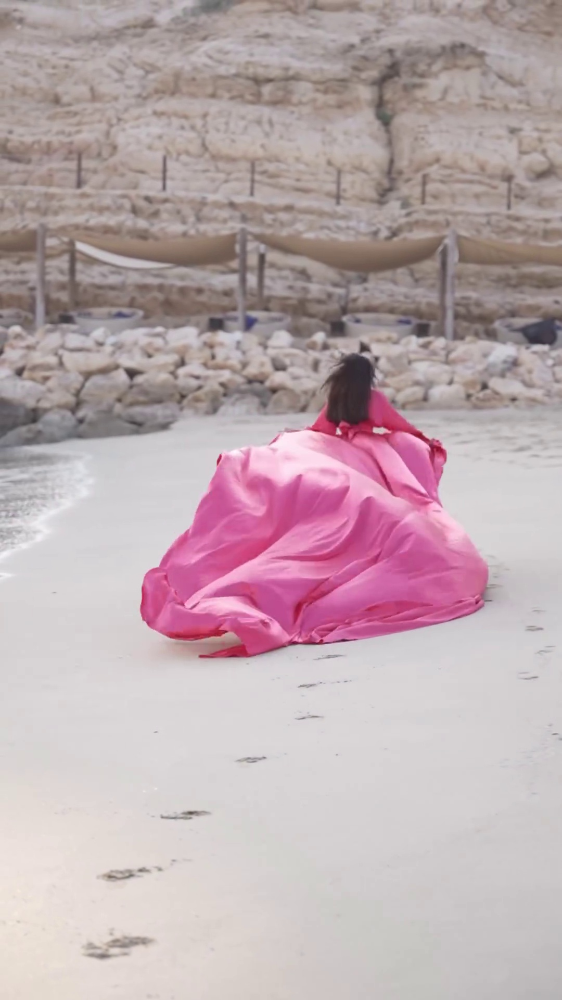

In [11]:
sample_period = 30  #sample every 30 frames
base64Frames_samples = base64Frames[0::sample_period]  #sample every 60 frames


print(len(base64Frames_samples), "frames sampled.")

display_handle = display(None, display_id=True)

for img in base64Frames_samples:
  data = base64.b64decode(img.encode("utf-8"))
  display_handle.update(Image(data=data, height = 500))
  time.sleep(0.25)

## Create Text of Narration for Video

We give the `base64Frames_samples` and some `instructions` to Vision to generate the narration text for the video. We can choose the style and duration of the narration.  We want it to be the length of the video.  People speak about 200 words per minute.  Using this, plus the number of frames `nframes` and the video framerate `fps`, you can figure out `nwords_max`, the maximum length of the narration.

In [13]:
wps = 200/60  #words per second in normal speech
nwords_max = round(nframes/fps*wps)  #max number of words in the voice over
print(f"Narration should have a maximum of {nwords_max} words")

instructions_oman = f'''These are frames from a video that I want to upload
for the Oman Tourism Board the promotes tourism to Oman.
Create a short narration script for this video in the style of an international
elegant female travel influencer that would get someone excited to visit Oman.
Make sure to mention Oman in the narration.
The narration should have less than {nwords_max} words.
Only include the narration.'''

instructions_yale = f'''These are frames from a video that I want to upload
for the Yale School of Management the promotes the Yale MBA program.
Create a short narration script for this video in the style of an international
elegant female travel influencer that would get someone excited to get
an MBA from Yale.
Make sure to mention Yale in the narration.
The narration should have less than {nwords_max} words.
Only include the narration.'''


#choose the appropriate instructions for your video
instructions = instructions_oman
image_urls = [f"data:image/jpeg;base64,{base64_image}" for base64_image in base64Frames_samples]
narration = generate_image_description(image_urls, instructions)
print(tr.fill(narration))



Narration should have a maximum of 77 words
Join me in Oman, where the sea kisses the desert, and history greets
you at every corner. From the serenity of the mountains to the warmth
of its people, Oman's beauty leaves you breathless. This hidden gem
awaits to unfold its secrets to you. Discover the magic of Oman.


## Check Word Count of Narration

In [14]:
nwords = len(narration.split(' '))
print(f"\nVideo voiceover has {nwords} words\nWe want a maximum of {nwords_max} words.")


Video voiceover has 49 words
We want a maximum of 77 words.


## Create Audio and Add to Video

I have cloned the influencer's voice (with permission) on Eleven Labs.  We will create the audio of the narration there, and then add it to the video using the video editing software on Online Video Editor.

1. Eleven Labs: https://elevenlabs.io/

2. Online Video Editor: https://online-video-cutter.com/video-editor


# Find Best Influencer for Brand Using Geometry

We have a brand and several influencers.  We want to find the best influencer for the brand based on the similarity of their content. We will embed the content of the influencers and the brand, and then see which user is closest to the brand in the embedding space.

The brand is
  1. Marina Bay Sands hotel in Singapore: @marinabaysands,  https://www.instagram.com/marinabaysands/

The influencers are

1. Seemona Rahman: @seemona.rahman, https://www.instagram.com/seemona.rahman/

2. Elona Karafin: @elona, https://www.instagram.com/elona/

3. Yamilesi Villavicencio: @iamaworld, https://www.instagram.com/iamaworld

## Embed Brand Data with ResNet

We have the Instagram posts of the brand in the folder `"data/MassDownloader/user_feed_marinabaysands"`.  We will load the images and then embed them with ResNet.  The embeddings will be saved in a dataframe `df_brand`.

In [15]:
username_brand = 'marinabaysands'
folder_brand = f'data/MassDownloader/user_feed_{username_brand}'

image_paths = [os.path.join(folder_brand, filename) for filename in os.listdir(folder_brand) if filename.lower().endswith('.jpg')]
print(f"Found {len(image_paths)} images for {username_brand}")

Found 10 images for marinabaysands


In [16]:
%%time
# Compute embedding using resnet

resnet_embedding = embed_images(image_paths)

# Standardize features
resnet_embedding = StandardScaler().fit_transform(resnet_embedding)
print(f"Shape of resnet embedding matrix is {resnet_embedding.shape}")

df_brand = pd.DataFrame({'image_path':image_paths})
df_brand['username'] = 'marinabaysands'
df_brand['resnet_embedding'] = resnet_embedding.tolist()

Embedding Images:   0%|          | 0/10 [00:00<?, ?it/s]

0/10 images processed..


Embedding Images: 100%|██████████| 10/10 [00:01<00:00,  6.85it/s]


Shape of resnet embedding matrix is (10, 2048)
CPU times: user 1.16 s, sys: 122 ms, total: 1.28 s
Wall time: 1.48 s


## Embed Influencer Data with ResNet

We have the Instagram posts of the brand in the folder `"data/MassDownloader/user_feed_{username_influencer}"`.  We will load the images and then embed them with ResNet.

We will combine `df_brand` and the dataframes in `df_list` into one giant dataframe `df` to simplify our analysis.

In [17]:
usernames_influencers = ['elona','iamaworld','seemona.rahman']
df_list = [df_brand]
for username in usernames_influencers:
  folder_influencer = f'data/MassDownloader/user_feed_{username}'
  image_paths = [os.path.join(folder_influencer, filename) for filename in os.listdir(folder_influencer) if filename.lower().endswith('.jpg')]
  image_paths = image_paths[:100]

  print(f"Found {len(image_paths)} images for {username}")
  resnet_embedding = embed_images(image_paths)

  df_influencer = pd.DataFrame({'image_path':image_paths})
  df_influencer['username'] = username
  df_influencer['resnet_embedding'] = resnet_embedding.tolist()
  df_list.append(df_influencer)

df = pd.concat(df_list)

Found 10 images for elona


Embedding Images:  30%|███       | 3/10 [00:00<00:00, 23.59it/s]

0/10 images processed..


Embedding Images: 100%|██████████| 10/10 [00:00<00:00, 25.95it/s]


Found 10 images for iamaworld


Embedding Images:  20%|██        | 2/10 [00:00<00:00, 18.33it/s]

0/10 images processed..


Embedding Images: 100%|██████████| 10/10 [00:00<00:00, 18.91it/s]


Found 10 images for seemona.rahman


Embedding Images:  30%|███       | 3/10 [00:00<00:00, 24.32it/s]

0/10 images processed..


Embedding Images: 100%|██████████| 10/10 [00:00<00:00, 26.12it/s]


## Embed Brand and Influencers with UMAP

We compute the 2-dimensional UMAP embedding of the ResNet image embeddings and add the columns to `df`.

In [18]:
resnet_embedding = df.resnet_embedding.tolist()
resnet_embedding = np.array(resnet_embedding)

umap = UMAP(n_neighbors=10,
            min_dist=0.1,
            metric='euclidean')
umap_embedding = umap.fit_transform(resnet_embedding)
df['umap_x'] = umap_embedding[:,0]
df['umap_y'] = umap_embedding[:,1]

## Plot Embeddings

We plot the UMAP embeddings of the images, and the mean UMAP embeddings for each user.  This let's us see who is closest to the brand.

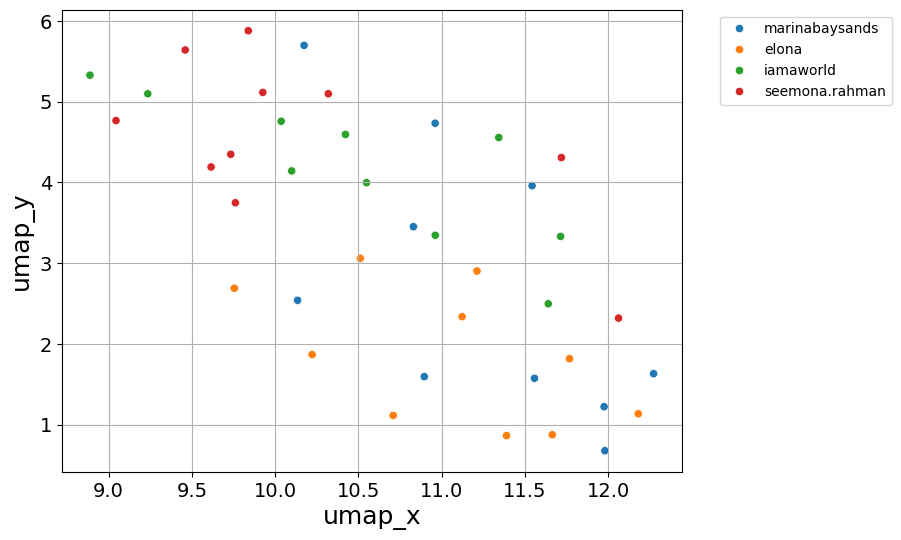

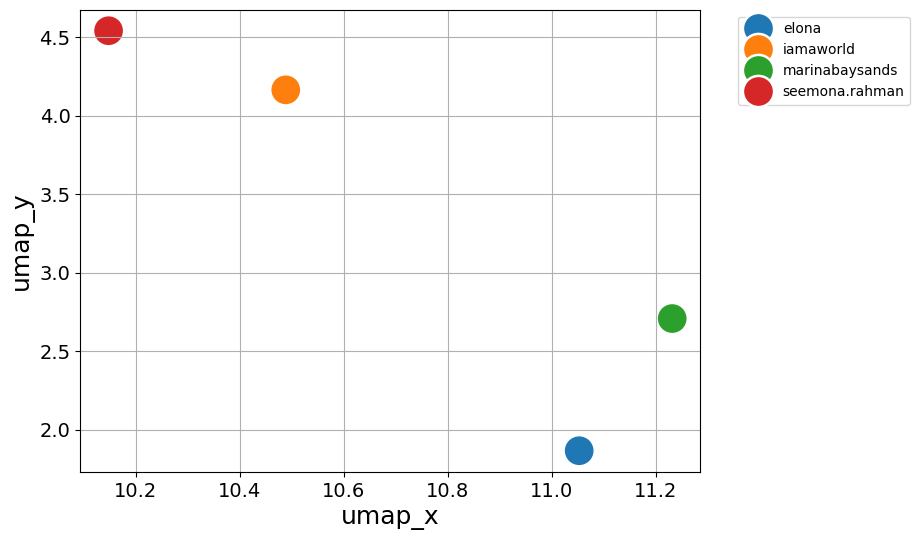

In [19]:
# Create scatterplot for individual images
plt.figure(figsize=(8, 6))  # Adjust size if needed
sns.scatterplot(data=df,
                x='umap_x',
                y='umap_y',
                hue='username')
# Move legend outside to the right
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid()
plt.show()


# Create scatterplot for individual users by averaging image coordinates
df_g = df.groupby('username').agg({'umap_x':'mean', 'umap_y':'mean'})
plt.figure(figsize=(8, 6))  # Adjust size if needed
sns.scatterplot(data=df_g,
                x='umap_x',
                y='umap_y',
                hue='username',
                s=504)

# Move legend outside to the right
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid()
plt.show()

## Find Closest Influencer to Brand


We compute the distance of each influencer to the brand.  The closest influencer is the best match according to this geometric approach.

In [20]:
df_g = df.groupby('username').agg({'umap_x':'mean', 'umap_y':'mean'})
x0, y0 = df_g.loc['marinabaysands'].values
df_g['distance'] = np.sqrt((df_g['umap_x'] - x0)**2 + (df_g['umap_y'] - y0)**2)
df_g = df_g.sort_values('distance')

username_match = df_g.iloc[1].name
print(f"The closest influencer to the brand is {username_match}")
df_g.head()

The closest influencer to the brand is elona


,umap_x,umap_y,distance
username,,,
marinabaysands,11.232135,2.707217,0.000000
elona,11.053133,1.865485,0.860555
iamaworld,10.488600,4.163814,1.635395
seemona.rahman,10.147736,4.540282,2.129800


# Find Best Influencer for Brand Using AI

Now we will give the data to the AI and have it decide which influencer is the best fit for the brand.

## Find the AI Matching Score of Each Influencer with the Brand

We feed the AI the images of the brand and the influencer.  The instructions ask it to calculate a score that tells us how well the influencer matches with the brand.  It will also explain how it got this score.

In [21]:
instructions = f'''You will be given some images posted by
the Marina Bay Sands hotel in Singapore.
You will also be given some images posted by an influencer.
You want to determine how good a fit the influencer is for the hotel
for a promotional campaign.  Return the matching score from
0 to 100, 0 meaning no match and 100 being a perfect match.
Also return why you got that score.  Return your answer as
an HTML text of width 400 and with format
SCORE: <score>,
REASON: <reason> '''

In [22]:
%%time
image_paths = df[df.username == username_brand]['image_path']
image_urls_brand = []
for cnt, image_path in enumerate(image_paths):
  base64_image = encode_image(image_path)
  image_url = f"data:image/jpeg;base64,{base64_image}"
  image_urls_brand.append(image_url)
  if cnt>=30:
    break


for username_influencer in usernames_influencers:
  print(f"Finding match score for {username_brand} and {username_influencer}")
  image_urls = image_urls_brand.copy()
  image_paths = df[df.username == username_influencer]['image_path']

  for cnt, image_path in enumerate(image_paths):
    base64_image = encode_image(image_path)
    image_url = f"data:image/jpeg;base64,{base64_image}"
    image_urls.append(image_url)
    if cnt>=30:
      break
  #Compute matching score of brand and influencer
  analysis = generate_image_description(image_urls, instructions)
  display(HTML(analysis))

Finding match score for marinabaysands and elona


Finding match score for marinabaysands and iamaworld


Finding match score for marinabaysands and seemona.rahman


CPU times: user 571 ms, sys: 131 ms, total: 701 ms
Wall time: 1min 36s


# Content for the Brand

We will take the best matching influencer and use AI to suggest some content ideas for the brand.

## Image Content

Lets create some image content in the style of the best matched influencer for the brand.  We will collect the image URLs of the brand and influencer in a list `image_urls` and give this to the AI, along with instructions telling it to make an Instagram post.



In [24]:
username_influencer = 'seemona.rahman'


In [25]:
image_paths = df[df.username == username_brand]['image_path']
image_urls = []
for cnt, image_path in enumerate(image_paths):
  base64_image = encode_image(image_path)
  image_url = f"data:image/jpeg;base64,{base64_image}"
  image_urls.append(image_url)
  if cnt>=30:
    break

image_paths = df[df.username == username_influencer]['image_path']

for cnt, image_path in enumerate(image_paths):
  base64_image = encode_image(image_path)
  image_url = f"data:image/jpeg;base64,{base64_image}"
  image_urls.append(image_url)
  if cnt>=30:
    break

In [26]:
#generate Instagram image description
topic = '''You should stay at the Marina Bay Sands hotel in Singapore'''
content = 'instagram image description'

instructions = f'''You will be given some images posted by
the Marina Bay Sands hotel in Singapore.
You will also be given some images posted by an influencer.
Create a {content} in the style of the influencer that
would convince their followers to want to {topic}. '''


image_description = generate_image_description(image_urls, instructions)





In [27]:
#generate Instagram image
ig_image_url, revised_prompt = generate_image(image_description)


In [28]:
#generate Instagram image caption
content = 'instagram image caption'

instructions = f'''Write an engaging Instagram caption that
would persuade someone to {topic}
for the image with description: {image_description}.
Retyurn only the caption.'''

ig_image_caption = generate_image_description([ig_image_url], instructions)





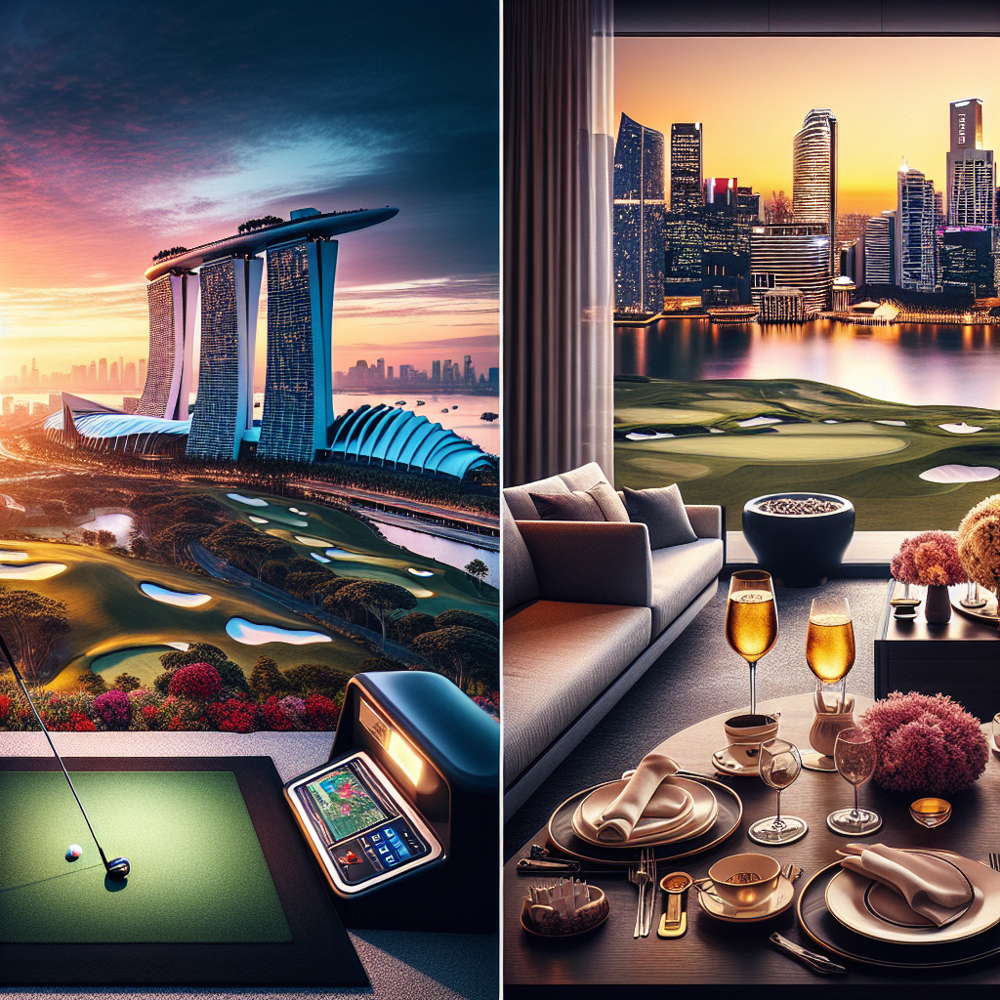

In [29]:
#display the Instagram post
display_IG(ig_image_caption, ig_image_url, username_influencer);

## Video Content

Lets create some video content in the style of the best matched influencer for the brand.  We will collect the image URLs of the brand and influencer in a list `image_urls` and give this to the AI, along with instructions telling it to make a script for the video.  The script has a scene number, description, and narration for each scene.  We will have the AI return this as an HTML table.




In [30]:
topic = '''You should stay at the Marina Bay Sands hotel in Singapore'''

instructions = f'''You will be given some images posted by
the Marina Bay Sands hotel in Singapore.
You will also be given some images posted by an influencer.
Create a script for an Instagram Reel with 5 scenes
 in the style of the influencer that
would convince their followers to want to {topic}.
Return your answer as an HTML table with columns
SCENE, DESCRIPTION, NARRATION.  Return only the HTML code.'''

script = generate_image_description(image_urls, instructions)

display(HTML(script))



SCENE,DESCRIPTION,NARRATION
1,Stylish suite with city view,"✨ Rise and shine in luxury at Marina Bay Sands, where every room is a gateway to the iconic Singapore skyline..."
2,Gourmet plate with caviar,🍽️ Indulge in the gourmet experience with world-renowned chefs serving up culinary masterpieces right here!
3,Indoor golf simulator,"⛳️ Even if you're not hitting the green outside, Marina Bay Sands lets you tee off in style with their indoor golf simulator..."
4,Elegant snacks and chess,"🧀 Relax with exclusive in-room amenities; from delectable snacks to leisurely games, sophistication is just a part of the stay..."
5,Infinity pool overlooking the city,🏊‍♀️ Take a dip in the world's most Instagrammed pool! Make a splash and your followers will swoon over the incredible views...


## Make the Video

If you want to actually make the movie, you have to convert the script HTML into a dataframe, and then generate the image for each scene.  You can then make the narration using Eleven Labs, and put it all together with Online Video Editor.

In [31]:
#convert script HTML into a dataframe
df_script = pd.read_html(script)[0]
df_script

,SCENE,DESCRIPTION,NARRATION
0,1,Stylish suite with city view,"✨ Rise and shine in luxury at Marina Bay Sands, where every room is a gateway to the iconic Singapore skyline..."
1,2,Gourmet plate with caviar,🍽️ Indulge in the gourmet experience with world-renowned chefs serving up culinary masterpieces right here!
2,3,Indoor golf simulator,"⛳️ Even if you're not hitting the green outside, Marina Bay Sands lets you tee off in style with their indoor golf simulator..."
3,4,Elegant snacks and chess,"🧀 Relax with exclusive in-room amenities; from delectable snacks to leisurely games, sophistication is just a part of the stay..."
4,5,Infinity pool overlooking the city,🏊‍♀️ Take a dip in the world's most Instagrammed pool! Make a splash and your followers will swoon over the incredible views...



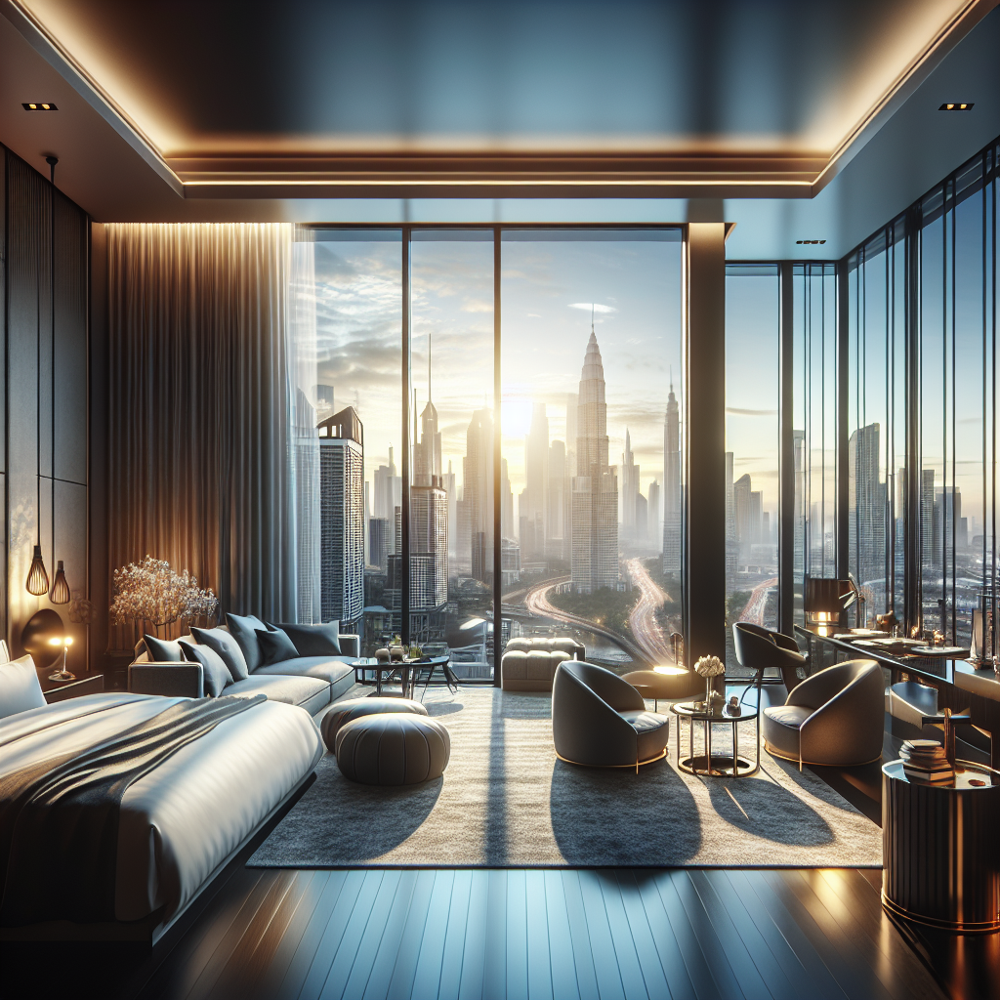


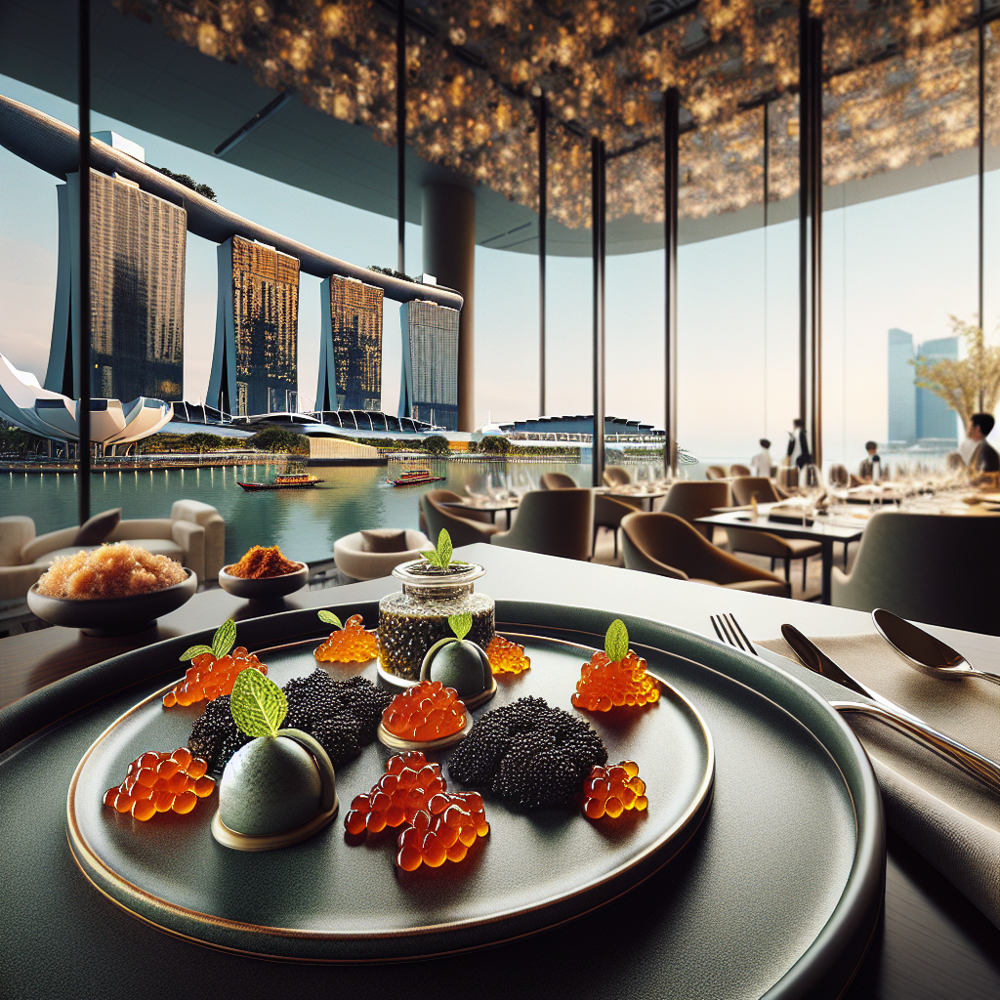


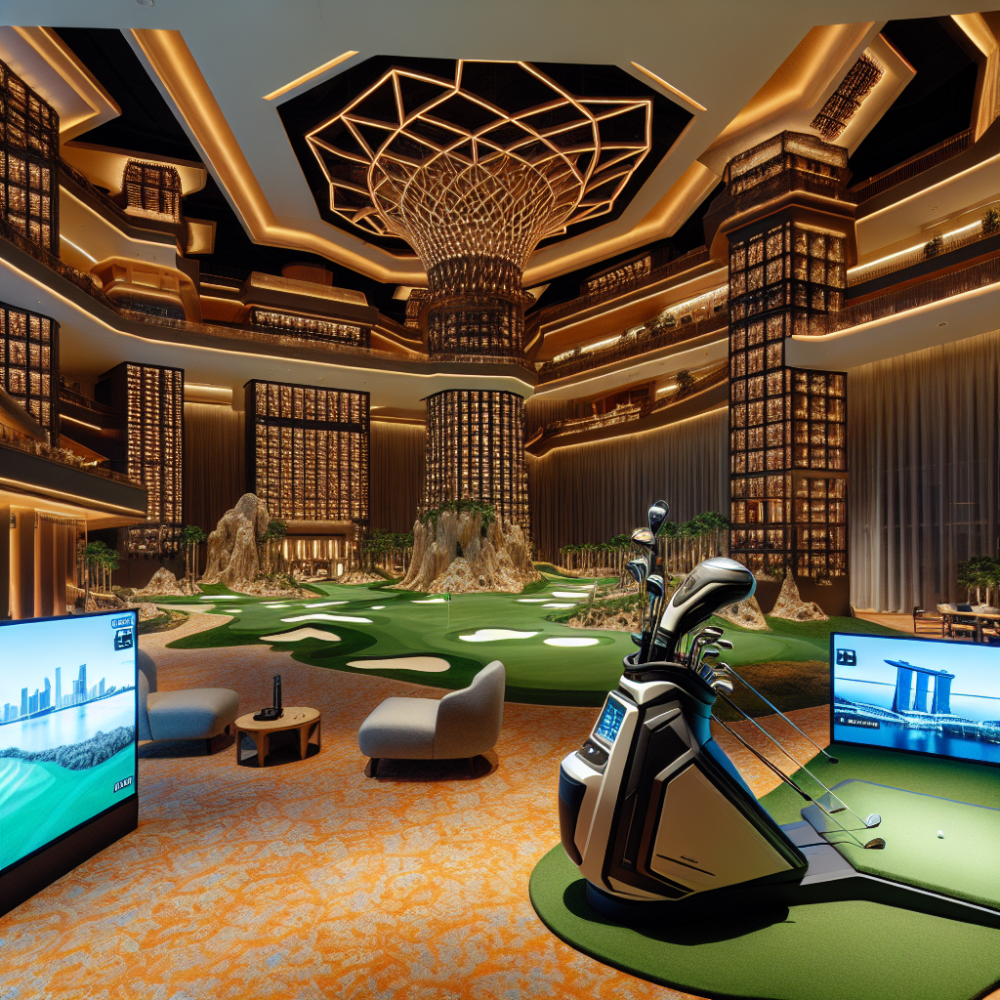


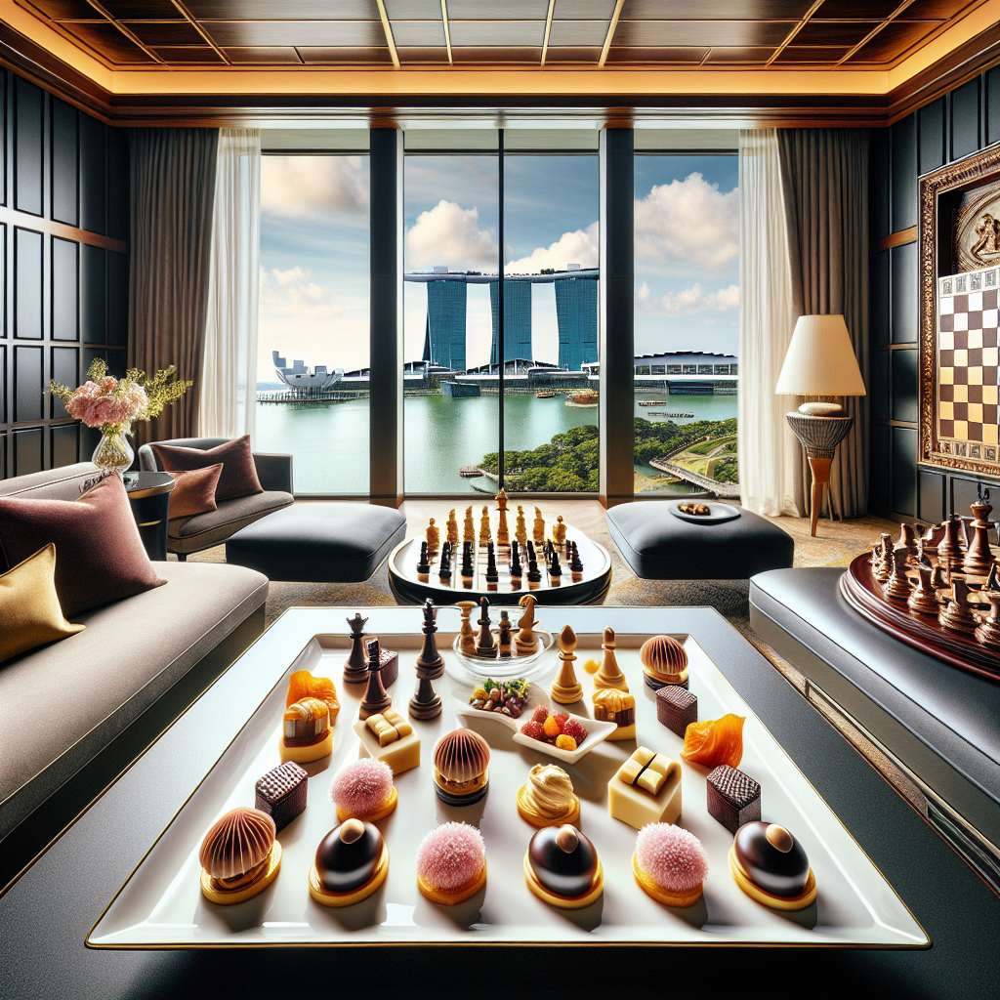


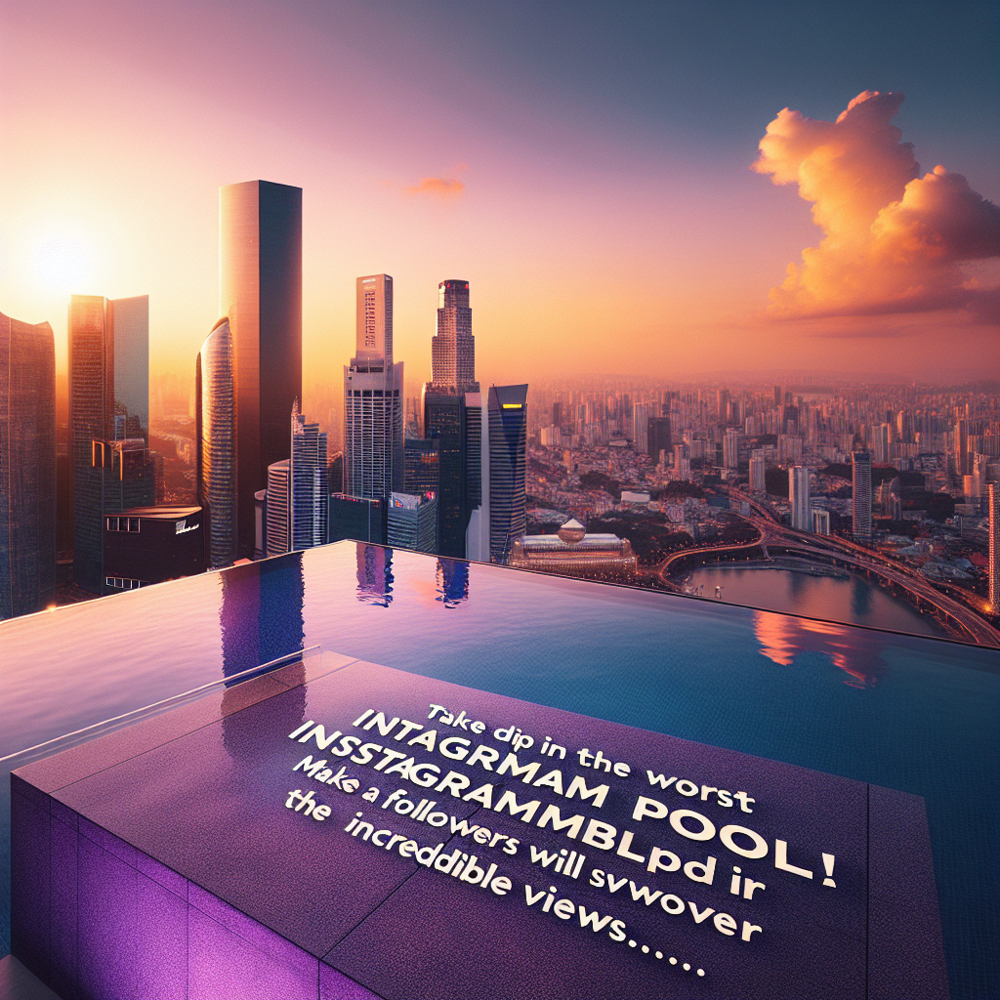

In [32]:
#create images for each scene in the script
for index, row in df_script.iterrows():
  prompt = f'''{row['DESCRIPTION']} in the Marina Bay Sands
  hotel in Singapore.  The narration for this image will be
  {row['NARRATION']}'''
  image_url, revised_prompt = generate_image(prompt)
  display_IG(row['NARRATION'], image_url, username_influencer);